In [34]:
import numpy as np
import matplotlib.pyplot as plt

from scipy.spatial.transform import Rotation as R
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.spatial.transform.Rotation.html#scipy.spatial.transform.Rotation

# my library of functions for this project l
# octa_lib contains vertices,faces of an octahedron 
from octa_lib import * 

%load_ext autoreload
%autoreload 1
%aimport octa_lib

# for reading images 
from pims import pipeline
from pims import Frame
import pims

from scipy.signal import savgol_filter

from skimage.draw import polygon
from skimage import feature
from skimage.feature import match_template

from skimage.filters import gaussian

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


nframes= 652 , frame shape = (512, 1280, 3)


Frame([[[ 50,  38,  50],
        [ 50,  38,  50],
        [ 49,  37,  49],
        ...,
        [ 33,  22,  31],
        [ 34,  25,  36],
        [ 33,  24,  35]],

       [[ 50,  38,  50],
        [ 47,  35,  47],
        [ 49,  37,  49],
        ...,
        [ 36,  25,  34],
        [ 34,  25,  36],
        [ 34,  25,  36]],

       [[ 49,  37,  53],
        [ 50,  38,  54],
        [ 44,  35,  50],
        ...,
        [ 31,  22,  35],
        [ 34,  25,  38],
        [ 33,  24,  37]],

       ...,

       [[107,  79, 100],
        [108,  80, 101],
        [106,  80,  99],
        ...,
        [ 36,  22,  35],
        [ 35,  24,  33],
        [ 33,  22,  31]],

       [[101,  80,  99],
        [ 98,  77,  96],
        [ 98,  77,  94],
        ...,
        [ 35,  23,  35],
        [ 37,  26,  35],
        [ 37,  26,  35]],

       [[ 99,  78,  97],
        [ 99,  78,  97],
        [ 95,  74,  91],
        ...,
        [ 33,  21,  33],
        [ 36,  25,  34],
        [ 36,  25,  34]]], dtype=uint8)
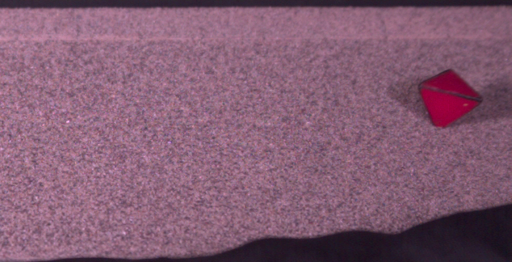

In [102]:
# read in video images 
frames_dir = 'Aug_2_2022/t10_*.png'
framesrgb = pims.open(frames_dir) 
print('nframes=',len(framesrgb),', frame shape =',framesrgb[10].shape)

# frames made this way from oct10.mp4 hight speed video
#/usr/local/bin/ffmpeg -i oct10.mp4  -ss 00:00:0.000 -vframes 1000 o10_%04d.png -hide_banner

fps =3000.0  #video fps ( is correct for oct10 video)
d4_edge = 20.0 #  mm with calipers measured red edge
theta_cam_deg = 45. # camera angle
theta_cam = theta_cam_deg*np.pi/180.0

oroot = 't10_' # for output files

framesrgb[30][0:400,500:1280]  # show what is in this video

Frame([[12., 12., 12., ...,  9.,  8.,  8.],
       [12., 12., 12., ...,  9.,  8.,  8.],
       [12., 12., 12., ...,  9.,  7.,  7.],
       ...,
       [28., 28., 26., ..., 13., 14., 14.],
       [24., 24., 19., ..., 12., 12., 12.],
       [24., 24., 19., ..., 12., 12., 12.]])
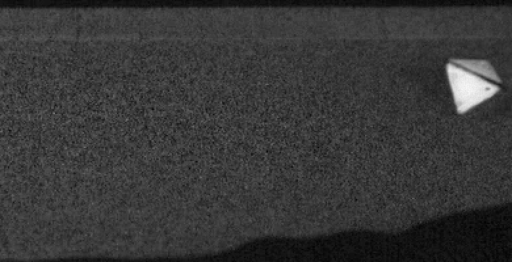

In [8]:
# bring out dice against background by subtracting green from red 
frames_1c=color_rgb(framesrgb,0,512,0,1280,1,-1,0)  # runs on pipeline
# subtract green from red
frames_1c[20][0:400,500:1280]  # series of 1 color frames!

Frame([[[ 51,  40,  49],
        [ 51,  40,  49],
        [ 50,  39,  48],
        ...,
        [ 42,  33,  46],
        [ 42,  30,  44],
        [ 42,  30,  44]],

       [[ 50,  39,  48],
        [ 51,  40,  49],
        [ 51,  40,  49],
        ...,
        [ 41,  32,  45],
        [ 43,  31,  45],
        [ 42,  30,  44]],

       [[ 52,  36,  51],
        [ 50,  34,  49],
        [ 48,  39,  54],
        ...,
        [ 38,  29,  40],
        [ 41,  27,  42],
        [ 43,  29,  44]],

       ...,

       [[166, 114, 135],
        [170, 118, 139],
        [160, 119, 133],
        ...,
        [ 38,  27,  34],
        [ 41,  26,  36],
        [ 41,  26,  36]],

       [[161, 113, 137],
        [161, 113, 137],
        [163, 115, 139],
        ...,
        [ 36,  27,  38],
        [ 35,  23,  37],
        [ 35,  23,  37]],

       [[161, 113, 137],
        [160, 112, 136],
        [165, 117, 141],
        ...,
        [ 35,  26,  37],
        [ 37,  25,  39],
        [ 36,  24,  38]]], dtype=uint8)
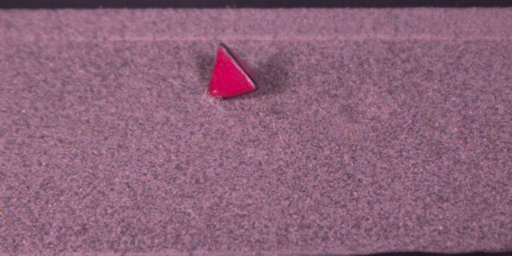

In [69]:
framesrgb[20+600][0:400,0:800]  # show what is in this video
# end at 300 frames if doing every other and starting from 20

In [90]:
p1 = tet_vertices[0,:]
p2 = tet_vertices[1,:]
d4_edge_model = np.sqrt(np.sum((p1-p2)**2))  # this is the length of the d4 edge
print('edge length d4 {:.2f}'.format(d4_edge_model))  #length of edge

# set the vertices and faces for the model
model_vertices = tet_vertices  # set shape model
model_faces = tet_faces 
model_g_angle = 2*np.pi/3  #this is the smallest angle for non-identity rotation 
#  in the rotation group of a tetrahedron

edge length d4 1.63


approximate center i0 = 153 j0=1151
scale factor = 56.6 pixels an edge
median =  33.0


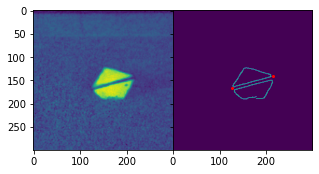

In [62]:
# adjust canny edge detection and find scale factor for dice size 
f0=40;   # which frame
dw=150   # size of subimages (halfsize)
canny_sigma = 2.3  # parameters for canny, low should be below median 
canny_low = 20; canny_high =50
#https://scikit-image.org/docs/stable/api/skimage.feature.html?highlight=canny#skimage.feature.canny
r0,c0,edges,subim,axarr = get_canny_edges(frames_1c,f0,dw,canny_sigma,canny_low,canny_high)

x0=126; x1=215  # adjust points so we can estimate the size of the dice
y0=166; y1=141
axarr[1].plot([x0,x1],[y0,y1],'ro',ms=2)
len_long = np.sqrt((x0-x1)**2 + (y0-y1)**2)
#print(len_long)  # this is the length of an edge
# take edge to scale to tetrahedron
scale_fac = len_long/d4_edge_model  
print('scale factor = {:.1f} pixels in an edge'.format(scale_fac))
print('median = ',np.median(subim)) # set the low threshold near but below the median

number of rotations = 43
number of rotations = 860


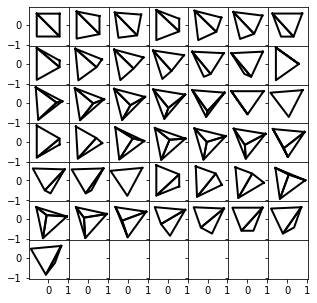

In [37]:
# generate templates
rot_list_base= rot_group_nearby(6,model_g_angle) # generate nearby rotations 
# nt=6 here gives 31, if you want more templates, increase this number
disp_rot_list(rot_list_base,model_vertices,model_faces)
extend_rot_list = rot_group_extend(rot_list_base,20) # extend the list of rotations 

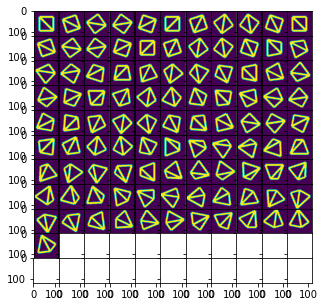

In [84]:
tem_scale_fac = 57 # set to be a bit larger than scale_fac 
# generate the large array of templates
template_arr=big_bin_rot_list3(extend_rot_list,model_vertices,model_faces,tem_scale_fac,5)  
# templates for long rotation list
# here 5 is half width of lines in pixels, I made lines thick! 
disp_img_arr(template_arr[0:100])  # show some of the templates for the longer list 

In [85]:
pixscale = (d4_edge/d4_edge_model)/ tem_scale_fac  # mm/pixel 
print('pixscale = {:.3f} mm/pixel'.format(pixscale))


pixscale = 0.215 mm/pixel


approximate center i0 = 154 j0=1168


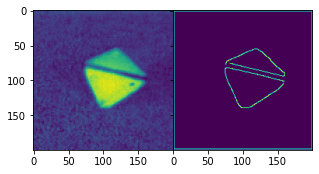

In [86]:
# adjust canny edge detection and chose start image 
f0=30;   # which frame
dw=100   # size of subimages (halfsize)
canny_sigma = 2.0  # parameters for canny, low should be below median 
canny_low = 20; canny_high =50
#https://scikit-image.org/docs/stable/api/skimage.feature.html?highlight=canny#skimage.feature.canny
r0,c0,edges,subim,axarr = get_canny_edges(frames_1c,f0,dw,canny_sigma,canny_low,canny_high)


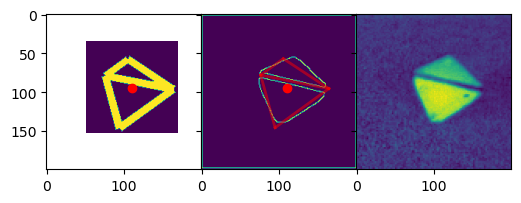

In [87]:
# find the nearest rotation in the large list of possible rotations 
best_rot,k,r,c,template= find_best_match(edges,template_arr,extend_rot_list)
# this takes a few minutes to run as it has to try hundreds of templates 
disp_best_match(subim,edges,r,c,template,best_rot,tem_scale_fac,model_vertices,model_faces)
# display result

In [88]:
# now find rotations for a sequence of frames
start_rot = best_rot  # rotation estimate for first frame
rstart = r+r0  # center of mass rows,cols in pixels
cstart = c+c0
tem_scale_fac=57  # scaling factor for model 
dw=100   # size of subimages 
canny_sigma = 2.3  # parameters for canny, low should be below median 
canny_low = 20; canny_high =50
f0=20  # first image frame, need not be the same as above choice, as long
# as there is not much difference in rotation. 
df = 2  #spacing between frames that we are tracking 
nf = 300  # number of images to track 
angle = 0.22;  # width of fine rotation grid
nl=5  # number of rotations in fine rotation grid  (5^3 = 125 rotations)

doing frame 20
number of rotations = 125
get_edges_rc: 48 248 1078 1278
doing frame 22
number of rotations = 125
get_edges_rc: 27 227 1114 1314
doing frame 24
number of rotations = 125
get_edges_rc: 32 232 1106 1306
doing frame 26
number of rotations = 125
get_edges_rc: 39 239 1102 1302
doing frame 28
number of rotations = 125
get_edges_rc: 40 240 1099 1299
doing frame 30
number of rotations = 125
get_edges_rc: 43 243 1089 1289
doing frame 32
number of rotations = 125
get_edges_rc: 48 248 1082 1282
doing frame 34
number of rotations = 125
get_edges_rc: 51 251 1074 1274
doing frame 36
number of rotations = 125
get_edges_rc: 56 256 1067 1267
doing frame 38
number of rotations = 125
get_edges_rc: 59 259 1061 1261
doing frame 40
number of rotations = 125
get_edges_rc: 61 261 1055 1255
doing frame 42
number of rotations = 125
get_edges_rc: 62 262 1050 1250
doing frame 44
number of rotations = 125
get_edges_rc: 63 263 1044 1244
doing frame 46
number of rotations = 125
get_edges_rc: 65 265 10

doing frame 250
number of rotations = 125
get_edges_rc: 30 230 643 843
doing frame 252
number of rotations = 125
get_edges_rc: 34 234 641 841
doing frame 254
number of rotations = 125
get_edges_rc: 31 231 636 836
doing frame 256
number of rotations = 125
get_edges_rc: 36 236 633 833
doing frame 258
number of rotations = 125
get_edges_rc: 37 237 627 827
doing frame 260
number of rotations = 125
get_edges_rc: 37 237 620 820
doing frame 262
number of rotations = 125
get_edges_rc: 42 242 617 817
doing frame 264
number of rotations = 125
get_edges_rc: 44 244 610 810
doing frame 266
number of rotations = 125
get_edges_rc: 45 245 606 806
doing frame 268
number of rotations = 125
get_edges_rc: 48 248 603 803
doing frame 270
number of rotations = 125
get_edges_rc: 49 249 597 797
doing frame 272
number of rotations = 125
get_edges_rc: 50 250 593 793
doing frame 274
number of rotations = 125
get_edges_rc: 48 248 590 790
doing frame 276
number of rotations = 125
get_edges_rc: 49 249 586 786
doing 

get_edges_rc: 20 220 313 513
doing frame 482
number of rotations = 125
get_edges_rc: 21 221 311 511
doing frame 484
number of rotations = 125
get_edges_rc: 21 221 309 509
doing frame 486
number of rotations = 125
get_edges_rc: 20 220 305 505
doing frame 488
number of rotations = 125
get_edges_rc: 20 220 304 504
doing frame 490
number of rotations = 125
get_edges_rc: 21 221 302 502
doing frame 492
number of rotations = 125
get_edges_rc: 20 220 299 499
doing frame 494
number of rotations = 125
get_edges_rc: 21 221 297 497
doing frame 496
number of rotations = 125
get_edges_rc: 21 221 295 495
doing frame 498
number of rotations = 125
get_edges_rc: 21 221 292 492
doing frame 500
number of rotations = 125
get_edges_rc: 19 219 290 490
doing frame 502
number of rotations = 125
get_edges_rc: 19 219 288 488
doing frame 504
number of rotations = 125
get_edges_rc: 19 219 286 486
doing frame 506
number of rotations = 125
get_edges_rc: 22 222 280 480
doing frame 508
number of rotations = 125
get_ed

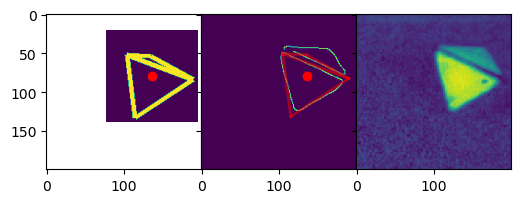

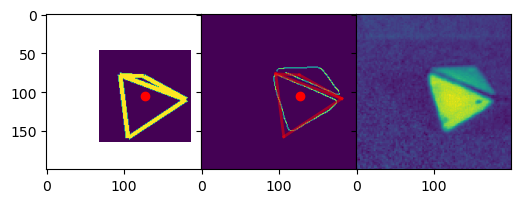

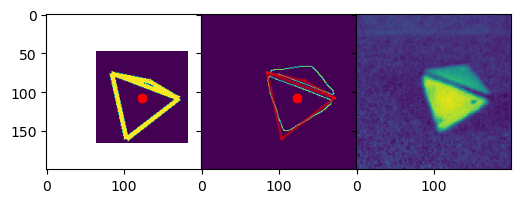

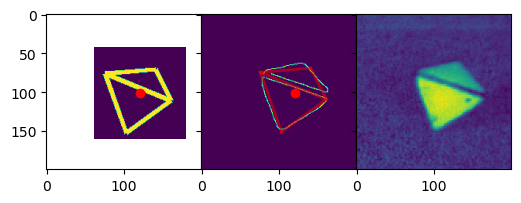

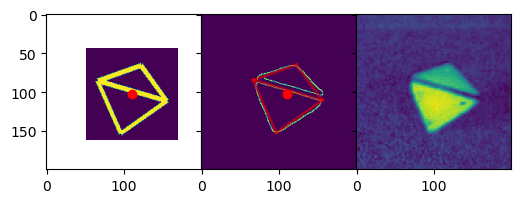

...

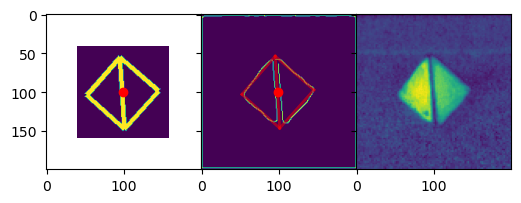

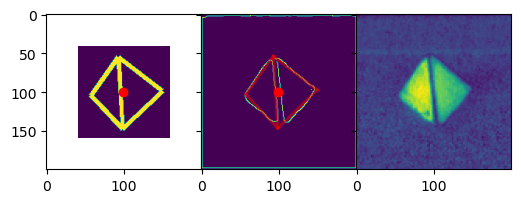

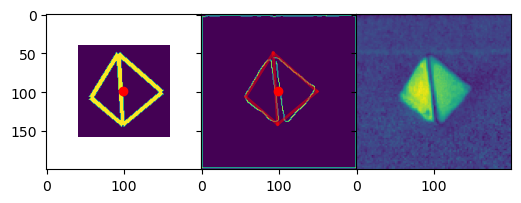

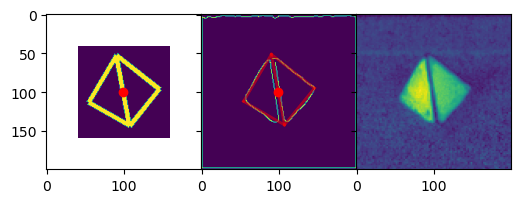

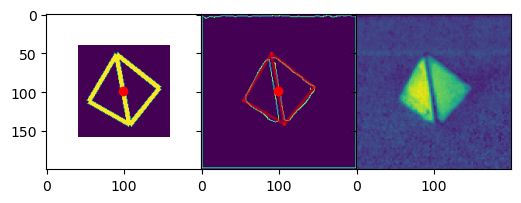

In [89]:
r_cen_list,c_cen_list,f0_list,frame_rot_list=do_sequence(frames_1c,start_rot,rstart,cstart,\
                dw,canny_sigma,canny_low,canny_high,\
                f0,df,nf,tem_scale_fac,angle,nl,model_vertices,model_faces)

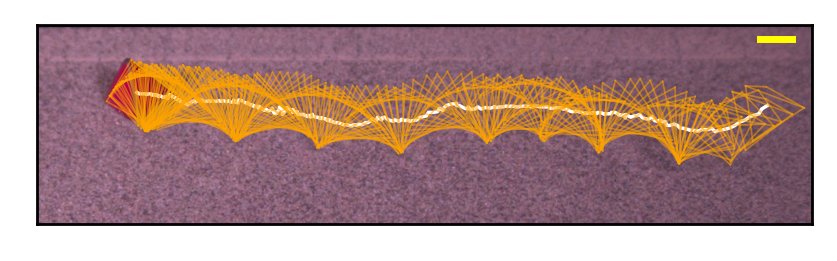

In [101]:
frame = framesrgb[622]  # choose background image 
ddf = 2;   # choose spacing in f0_list for tracked images for display
bbox = [10,300,150,1280]  # bounding box in pixels for figure
# show sequence 
ofile = oroot + 'seq.png'
plt_sequence(r_cen_list,c_cen_list,f0_list,frame_rot_list,tem_scale_fac,\
             frame,ddf,model_vertices,model_faces,bbox,pixscale,'orange',0.5,ofile)
# second to last argument is line width

# compute the spin vectors 
omega_arr = compute_spin_vec(frame_rot_list,f0_list,fps)

In [103]:
# plot trajectory and stuff 
# t0 is time from 0 in ms of impact, needs to be adjusted
# z0 is offset of z in mm, adjust this
# x0 is offset of x in mm, adjust this
def plt_traj(c_cen_list,r_cen_list,f0_list,omega_arr,pixscale,fps,\
             theta_cam,t0,z0,x0,ofile):
    tarr = (f0_list - t0)/fps *1e3 # in ms
    dt = (f0_list[1] - f0_list[0])/fps # in s
    omega_b = np.sqrt( omega_arr[:,0]**2 + omega_arr[:,1]**2 + omega_arr[:,2]**2)
    #  correct z for viewing angle with corr_fac at 45 degrees 
    corr_fac = np.cos(theta_cam)
    zarr = (-c_cen_list*pixscale+z0 ) /corr_fac  # in mm 
    xarr = r_cen_list*pixscale-x0  # x to mm 
    vxarr = savgol_filter(xarr,5,polyorder=1,deriv=1)/dt/1e3 # m/s
    vzarr = savgol_filter(zarr,5,polyorder=1,deriv=1)/dt/1e3 # m/s

    fig,axarr = plt.subplots(5,1,figsize=(4,6),sharex=True,sharey=False,dpi=150,facecolor='white')
    plt.subplots_adjust(hspace=0,wspace=0,left=0.2,right=0.98,top=0.98,bottom=0.15)
    axarr[0].plot(tarr,xarr)
    axarr[0].set_ylabel('x (mm)')
    axarr[1].plot(tarr,zarr)
    axarr[1].set_ylabel('z (mm)')  
    axarr[2].plot(tarr,vxarr)
    axarr[2].set_ylabel(r'$v_x$ (m/s)') 
    axarr[3].plot(tarr,vzarr)
    axarr[3].set_ylabel(r'$v_z$ (m/s)') 
    axarr[4].plot(tarr,omega_b,'.')
    axarr[4].set_ylabel('spin (1/s)')
    for k in range(5):
        yl,yh= axarr[k].get_ylim()
        axarr[k].plot([0,0],[yl,yh],':',color='grey',lw=1)
    xl,xh = axarr[0].get_xlim()
    axarr[0].plot([xl,xh],[0,0] ,':',color='grey',lw=1)
    axarr[1].plot([xl,xh],[0,0] ,':',color='grey',lw=1)
    #axarr[2].plot([-6,38],[0,0] ,':',color='grey',lw=1)
    axarr[3].plot([xl,xh],[0,0] ,':',color='grey',lw=1)
    #axarr[4].plot([xl,xh],[0,0] ,':',color='grey',lw=1)
    if (len(ofile) >3):
        fig.savefig(ofile,dpi=300)

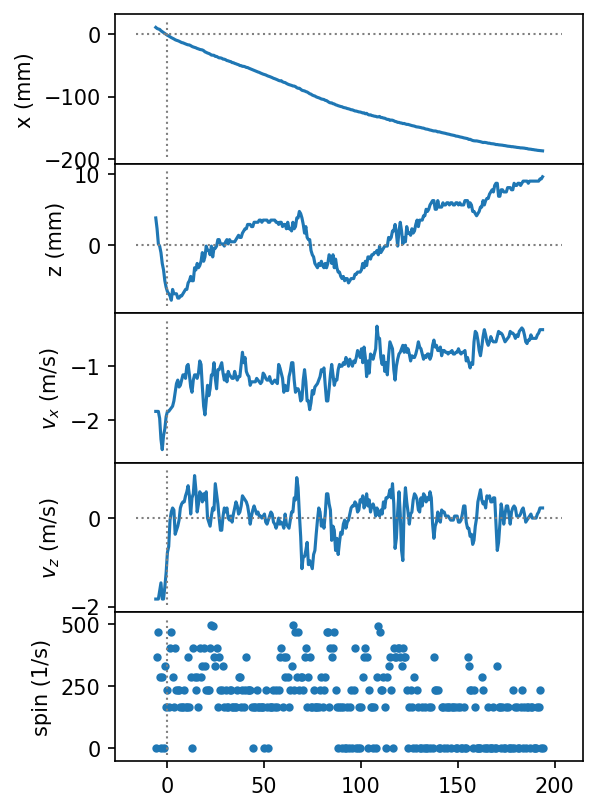

In [111]:
t0=37.0; x0=250; z0=30
ofile = ""
plt_traj(c_cen_list,r_cen_list,f0_list,omega_arr,pixscale,fps,\
             theta_cam,t0,z0,x0,ofile)